<a href="https://colab.research.google.com/github/guptaShourya/Mobility-Analytics/blob/main/MobilityAnalytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
!pip install -q dataprep
import warnings
warnings.filterwarnings('ignore')
from dataprep.eda import *

NumExpr defaulting to 2 threads.


In [2]:
train_path = "/content/drive/MyDrive/Machine Learning/Mobility Analytics/train_Wc8LBpr.csv"
# read data
data = pd.read_csv(train_path)

In [3]:
data.head(10)

,Trip_ID,Trip_Distance,Type_of_Cab,Customer_Since_Months,Life_Style_Index,Confidence_Life_Style_Index,Destination_Type,Customer_Rating,Cancellation_Last_1Month,Var1,Var2,Var3,Gender,Surge_Pricing_Type
0,T0005689460,6.77,B,1.0,2.42769,A,A,3.90500,0,40.0,46,60,Female,2
1,T0005689461,29.47,B,10.0,2.78245,B,A,3.45000,0,38.0,56,78,Male,2
2,T0005689464,41.58,NaN,10.0,NaN,NaN,E,3.50125,2,NaN,56,77,Male,2
3,T0005689465,61.56,C,10.0,NaN,NaN,A,3.45375,0,NaN,52,74,Male,3
4,T0005689467,54.95,C,10.0,3.03453,B,A,3.40250,4,51.0,49,102,Male,2
5,T0005689469,19.06,E,10.0,NaN,NaN,A,2.59750,1,72.0,63,91,Male,3
6,T0005689470,29.72,E,10.0,2.83958,C,B,2.97500,1,83.0,50,75,Male,2
7,T0005689472,18.44,B,2.0,2.81871,B,A,3.58250,0,103.0,46,63,Male,2
8,T0005689473,106.80,C,3.0,NaN,NaN,A,3.14625,0,NaN,58,92,Male,2
9,T0005689474,107.19,D,5.0,3.04467,B,A,2.44375,1,NaN,58,83,Male,3


In [4]:
# number of rows and columns in dataset
rows = data.shape[0]
columns = data.shape[1]
print("Data has {} rows, {} columns".format(rows, columns))

Data has 131662 rows, 14 columns


In [5]:
data.drop(['Trip_ID'], axis=1, inplace=True)

# SPLIT DATA

In [6]:
from sklearn.model_selection import train_test_split

# split data into train and validation part
train, val = train_test_split(data, test_size = 0.3, random_state = 5)

# UNIVARIATE ANALYSIS

In [7]:
train.head(10)

,Trip_Distance,Type_of_Cab,Customer_Since_Months,Life_Style_Index,Confidence_Life_Style_Index,Destination_Type,Customer_Rating,Cancellation_Last_1Month,Var1,Var2,Var3,Gender,Surge_Pricing_Type
98490,9.90,A,2.0,2.67373,A,B,3.28625,2,NaN,49,78,Male,1
37055,26.53,B,1.0,2.74663,A,A,2.54500,0,NaN,51,71,Male,2
56407,91.69,NaN,3.0,2.84348,B,A,1.42125,0,102.0,54,73,Male,2
47591,65.06,NaN,2.0,2.80567,C,B,0.01500,0,55.0,55,95,Male,3
79397,63.88,C,2.0,3.05402,A,A,3.12250,2,NaN,52,74,Male,2
74653,36.91,C,1.0,2.54269,B,A,2.28750,0,NaN,48,70,Male,2
8493,58.43,D,3.0,2.72195,B,A,1.65750,1,NaN,49,68,Male,3
76515,17.75,B,0.0,2.54894,B,F,3.48250,3,47.0,48,61,Male,2
74943,75.60,D,10.0,2.85765,B,B,1.88500,1,NaN,47,67,Male,2
32799,61.07,D,6.0,2.67286,B,A,2.15625,0,NaN,50,68,Male,3


## CONVERT CATEGORICALS

In [8]:
# mapping
TOC_replace = {'A':0, 'B':1, 'C':2, 'D':3, 'E':4, 'F':5, 'G':6, 'H':7, 'I':8, 'J':9, 'K':10, 'L':11, 'M':12, 'N':13}

# replace in Type_of_Cab
train['Type_of_Cab'] = train['Type_of_Cab'].replace(TOC_replace)
val['Type_of_Cab'] = val['Type_of_Cab'].replace(TOC_replace)
# replace in Confidence_Life_Style_Index
train['Confidence_Life_Style_Index'] = train['Confidence_Life_Style_Index'].replace(TOC_replace)
val['Confidence_Life_Style_Index'] = val['Confidence_Life_Style_Index'].replace(TOC_replace)
# replace in Destination_Type
train['Destination_Type'] = train['Destination_Type'].replace(TOC_replace)
val['Destination_Type'] = val['Destination_Type'].replace(TOC_replace)

In [9]:
# replace in Gender
gender_replace = {'Male':0, 'Female':1}

train['Gender'] = train['Gender'].replace(gender_replace)
val['Gender'] = val['Gender'].replace(gender_replace)

## HANDLE NULLS

Dropping Var1 becuase of more than 50% nulls

In [10]:
train.drop(['Var1'], axis=1, inplace=True)
val.drop(['Var1'], axis=1, inplace=True)

In [11]:
# columns with null and method to use to fill nulls
nulls_cols = {'Type_of_Cab':'mode', 'Customer_Since_Months':'median', 'Life_Style_Index':'median', 'Confidence_Life_Style_Index':'mode'}

#### NULLS V1: MEDIAN/MODE IMPUTATION
SINCE IN ALL THE OTHER COLUMNS EXPCET 'Customer_Since_Months' THERE ARE MORE THAN 10% NULLS, IT WOULD HAVE BEEN MEANINGFUL TO IMPUTE NULLS VIA ML STRATEGIES (DATAWIG IN PARTICULAR). BUT DUE TO ISSUES WITH DATAWIG IN COLAB WE'RE LEFT TO MODE/MEDIAN IMPUTATION.

In [12]:
def impute_nulls(train, test, column, method):
  '''
  imputes nulls for a given 'column' using mentioned 'method' in both 'train' and 'test'

  Args:
    train, test (Pandas Dataframe) : train & test datasets
    columns (string) : name of column to impute nulls in
    method (string) : method to use to fill nulls, either "mode" or "median"

  Returns:
    tuple : train, test datasets with imputed nulls
  '''
  # init value to be filled
  fill_val = -1
  # mode method
  if(method == 'mode'):
    fill_val = train[column].mode().values[0]
  # median method
  elif(method == 'median'):
    fill_val = train[column].median()
  # incorrect method
  else:
    print("ERROR: check method value, can either be median or mode.")
    return
  # replace nulls
  train.fillna(value=fill_val, inplace=True)
  test.fillna(value=fill_val, inplace=True)
  return (train, test)

In [13]:
# fill nulls
for col in nulls_cols:
  train, val = impute_nulls(train, val, col, nulls_cols[col])

Trip_Distance


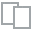
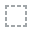
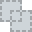
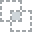
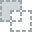
...
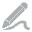
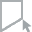
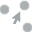
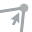
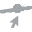

In [16]:
plot(train, col1='Trip_Distance')

Type_of_Cab


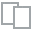
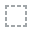
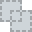
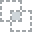
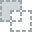
...
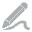
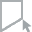
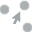
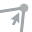
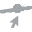

In [17]:
plot(train, col1='Type_of_Cab')

Customer_Since_Months

Zeros indicate a new customer


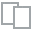
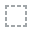
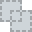
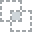
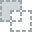
...
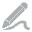
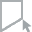
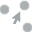
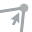
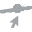

In [18]:
plot(train, col1='Customer_Since_Months')

Life_Style_Index

keeping outliers


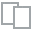
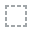
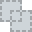
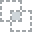
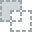
...
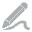
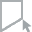
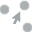
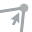
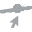

In [19]:
plot(train, col1='Life_Style_Index')

Confidence_Life_Style_Index

no idea what it is


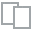
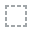
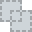
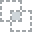
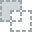
...
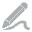
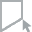
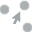
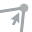
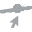

In [20]:
plot(train, col1='Confidence_Life_Style_Index')

Destination_Type

need further bivariate analysis


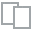
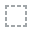
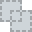
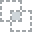
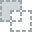
...
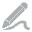
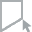
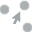
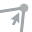
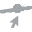

In [21]:
plot(train, col1='Destination_Type')

Customer_Rating

can be used with customer_since_months


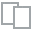
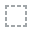
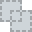
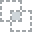
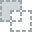
...
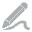
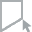
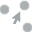
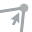
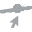

In [22]:
plot(train, col1='Customer_Rating')

Cancellation_Last_1Month

can be used with customer_since_monhts, and customer_rating. 
lower rating and more cancellations


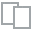
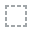
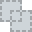
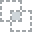
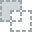
...
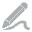
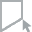
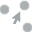
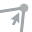
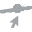

In [23]:
plot(train, col1='Cancellation_Last_1Month')

Var2


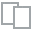
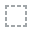
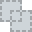
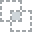
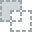
...
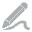
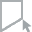
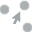
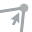
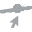

In [24]:
plot(train, col1='Var2')

Var3


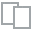
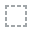
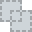
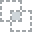
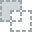
...
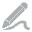
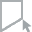
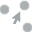
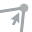
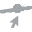

In [25]:
plot(train, col1='Var3')

Gender


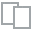
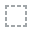
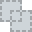
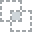
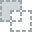
...
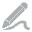
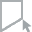
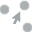
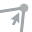
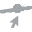

In [26]:
plot(train, col1='Gender')

Surge_Pricing_Type


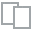
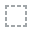
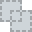
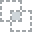
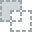
...
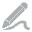
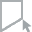
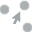
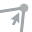
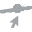

In [27]:
plot(train, 'Surge_Pricing_Type')